# Table of Contents
 <p><div class="lev1 toc-item"><a href="#Load-data" data-toc-modified-id="Load-data-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Load data</a></div><div class="lev1 toc-item"><a href="#ML-on-NSRDB-data" data-toc-modified-id="ML-on-NSRDB-data-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>ML on NSRDB data</a></div><div class="lev2 toc-item"><a href="#NSRDB-Clearsky" data-toc-modified-id="NSRDB-Clearsky-21"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>NSRDB Clearsky</a></div><div class="lev3 toc-item"><a href="#Visualize" data-toc-modified-id="Visualize-211"><span class="toc-item-num">2.1.1&nbsp;&nbsp;</span>Visualize</a></div><div class="lev2 toc-item"><a href="#PVLib-Clearsky" data-toc-modified-id="PVLib-Clearsky-22"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>PVLib Clearsky</a></div><div class="lev3 toc-item"><a href="#Visualize" data-toc-modified-id="Visualize-221"><span class="toc-item-num">2.2.1&nbsp;&nbsp;</span>Visualize</a></div><div class="lev2 toc-item"><a href="#Stat-smooth-Clearsky" data-toc-modified-id="Stat-smooth-Clearsky-23"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Stat smooth Clearsky</a></div><div class="lev3 toc-item"><a href="#Visualize" data-toc-modified-id="Visualize-231"><span class="toc-item-num">2.3.1&nbsp;&nbsp;</span>Visualize</a></div><div class="lev2 toc-item"><a href="#Conclusion" data-toc-modified-id="Conclusion-24"><span class="toc-item-num">2.4&nbsp;&nbsp;</span>Conclusion</a></div><div class="lev1 toc-item"><a href="#Ground-predictions" data-toc-modified-id="Ground-predictions-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Ground predictions</a></div><div class="lev2 toc-item"><a href="#PVLib-Clearsky" data-toc-modified-id="PVLib-Clearsky-31"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>PVLib Clearsky</a></div><div class="lev2 toc-item"><a href="#Statistical-Clearsky" data-toc-modified-id="Statistical-Clearsky-32"><span class="toc-item-num">3.2&nbsp;&nbsp;</span>Statistical Clearsky</a></div>

In [1]:
import pandas as pd
import numpy as np
import os
import datetime
import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
from sklearn import tree

import pytz
import itertools
import visualize
import utils
import pydotplus

from sklearn import metrics

import pvlib
import cs_detection
import visualize_plotly as visualize
# import visualize
# from bokeh.plotting import output_notebook
# output_notebook()

from IPython.display import Image

%load_ext autoreload
%autoreload 2

np.set_printoptions(precision=4)
%matplotlib notebook

# Load data

Read pickled data from data exploration notebook.

In [2]:
nsrdb = cs_detection.ClearskyDetection.read_pickle('abq_nsrdb_1.pkl.gz', compression='gzip')

In [3]:
ground = cs_detection.ClearskyDetection.read_pickle('abq_ground_1.pkl.gz', compression='gzip')

# ML on NSRDB data

## NSRDB Clearsky

In [4]:
nsrdb.calc_all_window_metrics(3, 30, col1='GHI', col2='Clearsky GHI', 
                              ratio_label='ratio', abs_ratio_diff_label='abs_diff_ratio')

In [5]:
nsrdb.df.keys()

Index(['GHI', 'Clearsky GHI', 'Cloud Type', 'sky_status', 'Clearsky GHI pvlib',
       'Clearsky GHI stat', 'Clearsky GHI stat smooth', 'ratio',
       'abs_diff_ratio', 'GHI mean', 'GHI std', 'GHI max', 'GHI min',
       'GHI range', 'Clearsky GHI mean', 'Clearsky GHI std',
       'Clearsky GHI max', 'Clearsky GHI min', 'Clearsky GHI range',
       'ratio mean', 'ratio std', 'ratio max', 'ratio min', 'ratio range',
       'abs_diff_ratio mean', 'abs_diff_ratio std', 'abs_diff_ratio max',
       'abs_diff_ratio min', 'abs_diff_ratio range', 'GHI gradient',
       'GHI gradient mean', 'GHI gradient std', 'GHI gradient max',
       'GHI gradient min', 'GHI gradient range', 'Clearsky GHI gradient',
       'Clearsky GHI gradient mean', 'Clearsky GHI gradient std',
       'Clearsky GHI gradient max', 'Clearsky GHI gradient min',
       'Clearsky GHI gradient range', 'ratio gradient', 'ratio gradient mean',
       'ratio gradient std', 'ratio gradient max', 'ratio gradient min',
       'rati

In [6]:
feature_cols = ['GHI', 'Clearsky GHI',
                'abs_diff_ratio', 'GHI mean', 'GHI std', 'GHI max', 'GHI min',
                'Clearsky GHI mean', 'Clearsky GHI std',
                'Clearsky GHI max', 'Clearsky GHI min',
                'abs_diff_ratio mean', 'abs_diff_ratio std', 'abs_diff_ratio max',
                'abs_diff_ratio min',  
                'GHI gradient',
                'GHI gradient mean', 'GHI gradient std', 'GHI gradient max',
                'GHI gradient min',  
                'Clearsky GHI gradient',
                'Clearsky GHI gradient mean', 'Clearsky GHI gradient std',
                'Clearsky GHI gradient max', 'Clearsky GHI gradient min',
                'abs_diff_ratio gradient',
                'abs_diff_ratio gradient mean', 'abs_diff_ratio gradient std',
                'abs_diff_ratio gradient max', 'abs_diff_ratio gradient min',
                'GHI line length', 'Clearsky GHI line length', 'abs_ratio_diff line length']
target_cols = ['sky_status']

In [7]:
clf = tree.DecisionTreeClassifier(class_weight='balanced', max_leaf_nodes=len(feature_cols))

In [8]:
clf = nsrdb.fit_model(feature_cols, target_cols, clf)

CV score: 0.942 +/- 0.001
Train/test split score: 0.9412077882567691


Training vs the clearsky model in NSRDB is quite accurate.  I don't really want to use this clearsky curve though since it's unavailable for ground based measurements.

### Visualize

In [9]:
train = cs_detection.ClearskyDetection(nsrdb.df)
train.trim_dates(None, '01-01-2015')
test = cs_detection.ClearskyDetection(nsrdb.df)
test.trim_dates('01-01-2015', None)

In [10]:
clf.fit(train.df[feature_cols], train.df[target_cols])

DecisionTreeClassifier(class_weight='balanced', criterion='gini',
            max_depth=None, max_features=None, max_leaf_nodes=31,
            min_impurity_split=1e-07, min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            presort=False, random_state=None, splitter='best')

In [11]:
pred = clf.predict(test.df[feature_cols]).flatten()

In [12]:
vis = visualize.Visualizer()

In [13]:
vis.add_line_ser(test.df['GHI'], 'GHI')
vis.add_line_ser(test.df['Clearsky GHI'], 'GHI_cs')
vis.add_circle_ser(test.df[(test.df['sky_status'] == 1) & (~pred)]['GHI'], 'NSRDB only')
vis.add_circle_ser(test.df[(test.df['sky_status'] == 0) & (pred)]['GHI'], 'ML only')
vis.add_circle_ser(test.df[(test.df['sky_status'] == 1) & (pred)]['GHI'], 'Both')

In [14]:
vis.show()

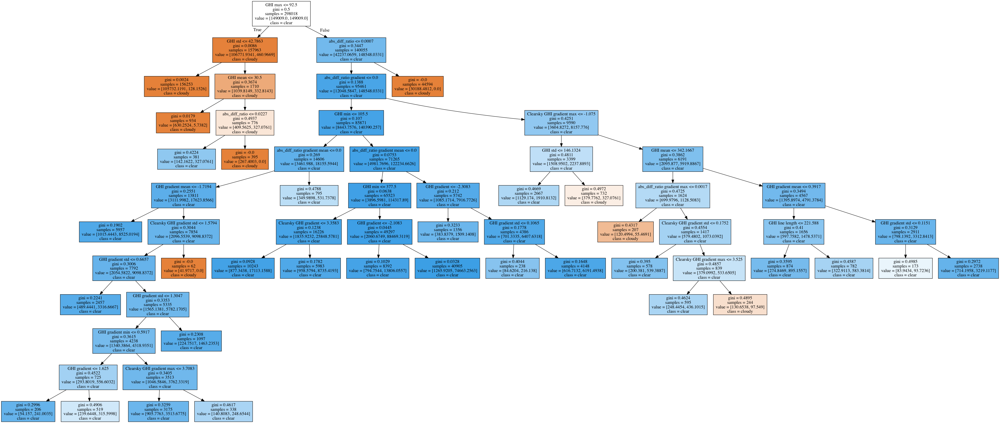

In [15]:
fdot = 'abq_nsrdb_nsrdb_cs.dot'
fpng = 'abq_nsrdb_nsrdb_cs.png'
tree.export_graphviz(clf, out_file=fdot, feature_names=feature_cols, class_names=['cloudy', 'clear'], filled=True)
!dot -Tpng {fdot} -o {fpng}
Image(fpng)

## PVLib Clearsky

In [16]:
nsrdb.scale_model('GHI', 'Clearsky GHI pvlib', 'sky_status')

In [17]:
nsrdb.calc_all_window_metrics(3, 30, col1='GHI', col2='Clearsky GHI pvlib', 
                              ratio_label='ratio', abs_ratio_diff_label='abs_diff_ratio', overwrite=True)

In [18]:
nsrdb.df.keys()

Index(['GHI', 'Clearsky GHI', 'Cloud Type', 'sky_status', 'Clearsky GHI pvlib',
       'Clearsky GHI stat', 'Clearsky GHI stat smooth', 'ratio',
       'abs_diff_ratio', 'GHI mean', 'GHI std', 'GHI max', 'GHI min',
       'GHI range', 'Clearsky GHI mean', 'Clearsky GHI std',
       'Clearsky GHI max', 'Clearsky GHI min', 'Clearsky GHI range',
       'ratio mean', 'ratio std', 'ratio max', 'ratio min', 'ratio range',
       'abs_diff_ratio mean', 'abs_diff_ratio std', 'abs_diff_ratio max',
       'abs_diff_ratio min', 'abs_diff_ratio range', 'GHI gradient',
       'GHI gradient mean', 'GHI gradient std', 'GHI gradient max',
       'GHI gradient min', 'GHI gradient range', 'Clearsky GHI gradient',
       'Clearsky GHI gradient mean', 'Clearsky GHI gradient std',
       'Clearsky GHI gradient max', 'Clearsky GHI gradient min',
       'Clearsky GHI gradient range', 'ratio gradient', 'ratio gradient mean',
       'ratio gradient std', 'ratio gradient max', 'ratio gradient min',
       'rati

In [19]:
feature_cols = ['GHI', 'Clearsky GHI pvlib',
                'abs_diff_ratio', 'GHI mean', 'GHI std', 'GHI max', 'GHI min',
                'Clearsky GHI pvlib mean', 'Clearsky GHI pvlib std',
                'Clearsky GHI pvlib max', 'Clearsky GHI pvlib min',
                'abs_diff_ratio mean', 'abs_diff_ratio std', 'abs_diff_ratio max',
                'abs_diff_ratio min',  
                'GHI gradient',
                'GHI gradient mean', 'GHI gradient std', 'GHI gradient max',
                'GHI gradient min',  
                'Clearsky GHI pvlib gradient',
                'Clearsky GHI pvlib gradient mean', 'Clearsky GHI pvlib gradient std',
                'Clearsky GHI pvlib gradient max', 'Clearsky GHI pvlib gradient min',
                'abs_diff_ratio gradient',
                'abs_diff_ratio gradient mean', 'abs_diff_ratio gradient std',
                'abs_diff_ratio gradient max', 'abs_diff_ratio gradient min',
                'GHI line length', 'Clearsky GHI pvlib line length', 'abs_ratio_diff line length']
target_cols = ['sky_status']

In [20]:
clf = tree.DecisionTreeClassifier(class_weight='balanced', max_leaf_nodes=len(feature_cols))

In [21]:
clf = nsrdb.fit_model(feature_cols, target_cols, clf)

CV score: 0.9387 +/- 0.0007
Train/test split score: 0.9398007301490721


Using the PVLib clearsky yields similar results to the NSRDB clearsky curve.  The advantage of the PVLib curve is we can compute it ground based measurements if we have the location.

### Visualize

In [22]:
train = cs_detection.ClearskyDetection(nsrdb.df)
train.trim_dates(None, '01-01-2015')
test = cs_detection.ClearskyDetection(nsrdb.df)
test.trim_dates('01-01-2015', None)

In [23]:
clf.fit(train.df[feature_cols], train.df[target_cols])

DecisionTreeClassifier(class_weight='balanced', criterion='gini',
            max_depth=None, max_features=None, max_leaf_nodes=33,
            min_impurity_split=1e-07, min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            presort=False, random_state=None, splitter='best')

In [24]:
pred = clf.predict(test.df[feature_cols]).flatten()

In [25]:
vis = visualize.Visualizer()

In [26]:
vis.add_line_ser(test.df['GHI'], 'GHI')
vis.add_line_ser(test.df['Clearsky GHI pvlib'], 'GHI_cs')
vis.add_circle_ser(test.df[(test.df['sky_status'] == 1) & (~pred)]['GHI'], 'NSRDB only')
vis.add_circle_ser(test.df[(test.df['sky_status'] == 0) & (pred)]['GHI'], 'ML only')
vis.add_circle_ser(test.df[(test.df['sky_status'] == 1) & (pred)]['GHI'], 'Both')

In [27]:
vis.show()

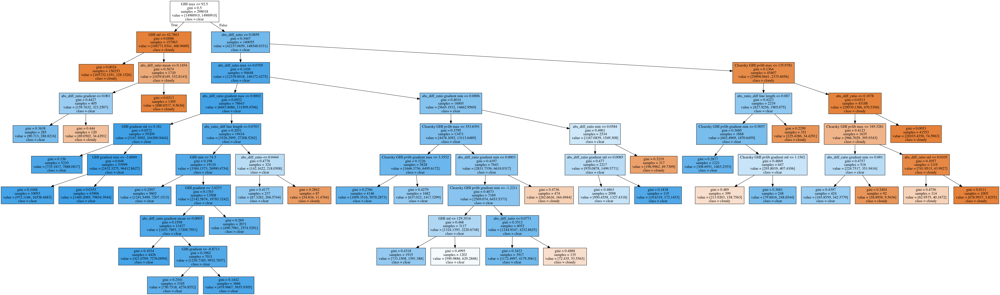

In [28]:
fdot = 'abq_nsrdb_pvlib_cs.dot'
fpng = 'abq_nsrdb_pvlib_cs.png'
tree.export_graphviz(clf, out_file=fdot, feature_names=feature_cols, class_names=['cloudy', 'clear'], filled=True)
!dot -Tpng {fdot} -o {fpng}
Image(fpng)

## Stat smooth Clearsky

In [29]:
nsrdb.scale_model('GHI', 'Clearsky GHI stat smooth', 'sky_status')

In [30]:
nsrdb.calc_all_window_metrics(3, 30, col1='GHI', col2='Clearsky GHI stat smooth', 
                              ratio_label='ratio', abs_ratio_diff_label='abs_diff_ratio', overwrite=True)

In [31]:
nsrdb.df.keys()

Index(['GHI', 'Clearsky GHI', 'Cloud Type', 'sky_status', 'Clearsky GHI pvlib',
       'Clearsky GHI stat', 'Clearsky GHI stat smooth', 'ratio',
       'abs_diff_ratio', 'GHI mean', 'GHI std', 'GHI max', 'GHI min',
       'GHI range', 'Clearsky GHI mean', 'Clearsky GHI std',
       'Clearsky GHI max', 'Clearsky GHI min', 'Clearsky GHI range',
       'ratio mean', 'ratio std', 'ratio max', 'ratio min', 'ratio range',
       'abs_diff_ratio mean', 'abs_diff_ratio std', 'abs_diff_ratio max',
       'abs_diff_ratio min', 'abs_diff_ratio range', 'GHI gradient',
       'GHI gradient mean', 'GHI gradient std', 'GHI gradient max',
       'GHI gradient min', 'GHI gradient range', 'Clearsky GHI gradient',
       'Clearsky GHI gradient mean', 'Clearsky GHI gradient std',
       'Clearsky GHI gradient max', 'Clearsky GHI gradient min',
       'Clearsky GHI gradient range', 'ratio gradient', 'ratio gradient mean',
       'ratio gradient std', 'ratio gradient max', 'ratio gradient min',
       'rati

In [32]:
feature_cols = ['GHI', 'Clearsky GHI stat smooth',
                'abs_diff_ratio', 'GHI mean', 'GHI std', 'GHI max', 'GHI min',
                'Clearsky GHI stat smooth mean', 'Clearsky GHI stat smooth std',
                'Clearsky GHI stat smooth max', 'Clearsky GHI stat smooth min',
                'abs_diff_ratio mean', 'abs_diff_ratio std', 'abs_diff_ratio max',
                'abs_diff_ratio min',  
                'GHI gradient',
                'GHI gradient mean', 'GHI gradient std', 'GHI gradient max',
                'GHI gradient min',  
                'Clearsky GHI stat smooth gradient',
                'Clearsky GHI stat smooth gradient mean', 'Clearsky GHI stat smooth gradient std',
                'Clearsky GHI stat smooth gradient max', 'Clearsky GHI stat smooth gradient min',
                'abs_diff_ratio gradient',
                'abs_diff_ratio gradient mean', 'abs_diff_ratio gradient std',
                'abs_diff_ratio gradient max', 'abs_diff_ratio gradient min',
                'GHI line length', 'Clearsky GHI stat smooth line length', 'abs_ratio_diff line length']
target_cols = ['sky_status']

In [33]:
clf = tree.DecisionTreeClassifier(class_weight='balanced', max_leaf_nodes=len(feature_cols))

In [34]:
clf = nsrdb.fit_model(feature_cols, target_cols, clf)

CV score: 0.9304 +/- 0.0015
Train/test split score: 0.9279104553290741


Using the smoothed statistical clearsky curve gives results that are slightly less accurate than the NSRDB and PVLib curves.  This is also a candidate to be used in future work since it can be computed for ground based measruements (even without location information).

### Visualize

In [35]:
train = cs_detection.ClearskyDetection(nsrdb.df)
train.trim_dates(None, '01-01-2015')
test = cs_detection.ClearskyDetection(nsrdb.df)
test.trim_dates('01-01-2015', None)

In [36]:
clf.fit(train.df[feature_cols], train.df[target_cols])

DecisionTreeClassifier(class_weight='balanced', criterion='gini',
            max_depth=None, max_features=None, max_leaf_nodes=33,
            min_impurity_split=1e-07, min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            presort=False, random_state=None, splitter='best')

In [37]:
pred = clf.predict(test.df[feature_cols]).flatten()

In [38]:
vis = visualize.Visualizer()

In [39]:
vis.add_line_ser(test.df['GHI'], 'GHI')
vis.add_line_ser(test.df['Clearsky GHI stat smooth'], 'GHI_cs')
vis.add_circle_ser(test.df[(test.df['sky_status'] == 1) & (~pred)]['GHI'], 'NSRDB only')
vis.add_circle_ser(test.df[(test.df['sky_status'] == 0) & (pred)]['GHI'], 'ML only')
vis.add_circle_ser(test.df[(test.df['sky_status'] == 1) & (pred)]['GHI'], 'Both')

In [40]:
vis.show()

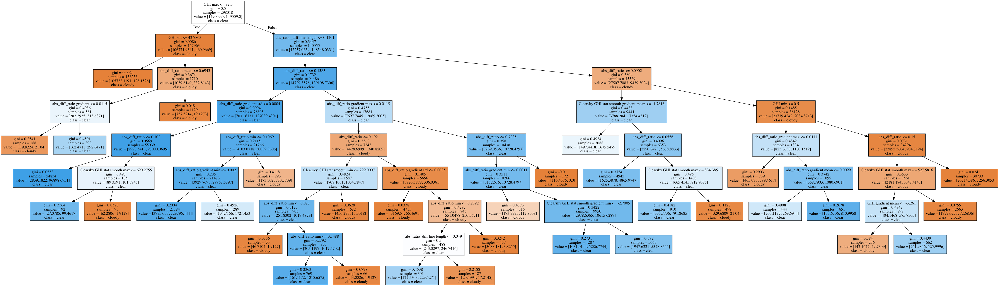

In [41]:
fdot = 'abq_nsrdb_stat_cs.dot'
fpng = 'abq_nsrdb_stat_cs.png'
tree.export_graphviz(clf, out_file=fdot, feature_names=feature_cols, class_names=['cloudy', 'clear'], filled=True)
!dot -Tpng {fdot} -o {fpng}
Image(fpng)

## Conclusion

All three methods perform admirably.  It looks like 'obvious' errors are few and far between.  The big interest now is which method will perform best when NSRDB data is trained and tested on ground data.

# Ground predictions

## PVLib Clearsky

Only making ground predictions using PVLib clearsky model and statistical model.  NSRDB model won't be available to ground measurements.

In [42]:
nsrdb = cs_detection.ClearskyDetection.read_pickle('abq_nsrdb_1.pkl.gz')

In [43]:
ground = cs_detection.ClearskyDetection.read_pickle('abq_ground_1.pkl.gz')

We will reduce the frequency of ground based measurements to match NSRDB.

In [44]:
ground.intersection(nsrdb.df.index)

In [45]:
nsrdb.scale_model('GHI', 'Clearsky GHI pvlib', 'sky_status')

In [46]:
ground.trim_dates('10-01-2015', None)

In [47]:
nsrdb.calc_all_window_metrics(3, 30, col1='GHI', col2='Clearsky GHI pvlib', 
                              ratio_label='ratio', abs_ratio_diff_label='abs_diff_ratio', overwrite=True)

In [48]:
ground.calc_all_window_metrics(3, 30, col1='GHI', col2='Clearsky GHI pvlib', 
                               ratio_label='ratio', abs_ratio_diff_label='abs_diff_ratio', overwrite=True)

In [49]:
feature_cols = ['GHI', 'Clearsky GHI pvlib',
                'abs_diff_ratio', 'GHI mean', 'GHI std', 'GHI max', 'GHI min',
                'Clearsky GHI pvlib mean', 'Clearsky GHI pvlib std',
                'Clearsky GHI pvlib max', 'Clearsky GHI pvlib min',
                'abs_diff_ratio mean', 'abs_diff_ratio std', 'abs_diff_ratio max',
                'abs_diff_ratio min',  
                'GHI gradient',
                'GHI gradient mean', 'GHI gradient std', 'GHI gradient max',
                'GHI gradient min',  
                'Clearsky GHI pvlib gradient',
                'Clearsky GHI pvlib gradient mean', 'Clearsky GHI pvlib gradient std',
                'Clearsky GHI pvlib gradient max', 'Clearsky GHI pvlib gradient min',
                'abs_diff_ratio gradient',
                'abs_diff_ratio gradient mean', 'abs_diff_ratio gradient std',
                'abs_diff_ratio gradient max', 'abs_diff_ratio gradient min',
                'GHI line length', 'Clearsky GHI pvlib line length', 
                'abs_ratio_diff line length']
target_cols = ['sky_status']

In [50]:
train = cs_detection.ClearskyDetection(nsrdb.df)
test = cs_detection.ClearskyDetection(ground.df)

In [51]:
clf = tree.DecisionTreeClassifier(class_weight='balanced', max_leaf_nodes=len(feature_cols))

In [52]:
clf.fit(train.df[feature_cols].values, train.df[target_cols].values.flatten())

DecisionTreeClassifier(class_weight='balanced', criterion='gini',
            max_depth=None, max_features=None, max_leaf_nodes=33,
            min_impurity_split=1e-07, min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            presort=False, random_state=None, splitter='best')

In [53]:
# pred = clf.predict(test.df[feature_cols].values)
pred = test.iter_predict(feature_cols, 'GHI', 'Clearsky GHI pvlib', clf, 3)
pred = pred.astype(bool)

1 1
2 0.971742309692
3 0.997307283758
4 0.999932990745
5 1.0


In [54]:
train.intersection(test.df.index)

In [55]:
metrics.accuracy_score(train.df['sky_status'].values, pred)

0.91309255079006768

In [56]:
vis = visualize.Visualizer()

In [57]:
vis.add_line_ser(test.df['GHI'], 'GHI')
vis.add_line_ser(test.df['Clearsky GHI pvlib'], 'GHI_cs')
vis.add_circle_ser(test.df[(train.df['sky_status'] == 0) & (pred)]['GHI'], 'ML clear only')
vis.add_circle_ser(test.df[(train.df['sky_status'] == 1) & (~pred)]['GHI'], 'NSRDB clear only')
vis.add_circle_ser(test.df[(train.df['sky_status'] == 1) & (pred)]['GHI'], 'ML+NSRDB clear only')

In [58]:
vis.show()

In [59]:
ground = cs_detection.ClearskyDetection.read_pickle('abq_ground_1.pkl.gz')

In [60]:
ground.trim_dates('10-01-2015', '11-01-2015')

In [61]:
test = ground

In [62]:
# pred = clf.predict(test.df[feature_cols].values)
pred = test.iter_predict(feature_cols, 'GHI', 'Clearsky GHI pvlib', clf, 10)
pred = pred.astype(bool)

1 1
2 0.977881635047
3 0.990390408634
4 0.997736405338
5 0.999364161482
6 0.999912210883


In [63]:
vis = visualize.Visualizer()

In [64]:
vis.add_line_ser(test.df['GHI'], 'GHI')
vis.add_line_ser(test.df['Clearsky GHI pvlib'], 'GHI_cs')
vis.add_circle_ser(test.df[(test.df['sky_status pvlib'] == 0) & (pred)]['GHI'], 'ML clear only')
vis.add_circle_ser(test.df[(test.df['sky_status pvlib'] == 1) & (~pred)]['GHI'], 'PVLib clear only')
vis.add_circle_ser(test.df[(test.df['sky_status pvlib'] == 1) & (pred)]['GHI'], 'ML+PVLib clear only')

In [65]:
vis.show()

## Statistical Clearsky

Only making ground predictions using PVLib clearsky model and statistical model.  NSRDB model won't be available to ground measurements.

In [66]:
nsrdb = cs_detection.ClearskyDetection.read_pickle('abq_nsrdb_1.pkl.gz')

In [67]:
ground = cs_detection.ClearskyDetection.read_pickle('abq_ground_1.pkl.gz')

We will reduce the frequency of ground based measurements to match NSRDB.

In [68]:
nsrdb.scale_model('GHI', 'Clearsky GHI stat smooth', 'sky_status')

In [69]:
ground.intersection(nsrdb.df.index)

In [70]:
ground.trim_dates('10-01-2015', None)

In [71]:
nsrdb.calc_all_window_metrics(3, 30, col1='GHI', col2='Clearsky GHI stat smooth', 
                              ratio_label='ratio', abs_ratio_diff_label='abs_diff_ratio', overwrite=True)

In [72]:
ground.calc_all_window_metrics(3, 30, col1='GHI', col2='Clearsky GHI stat smooth', 
                               ratio_label='ratio', abs_ratio_diff_label='abs_diff_ratio', overwrite=True)

In [73]:
feature_cols = ['GHI', 'Clearsky GHI stat smooth',
                'abs_diff_ratio', 'GHI mean', 'GHI std', 'GHI max', 'GHI min',
                'Clearsky GHI stat smooth mean', 'Clearsky GHI stat smooth std',
                'Clearsky GHI stat smooth max', 'Clearsky GHI stat smooth min',
                'abs_diff_ratio mean', 'abs_diff_ratio std', 'abs_diff_ratio max',
                'abs_diff_ratio min',  
                'GHI gradient',
                'GHI gradient mean', 'GHI gradient std', 'GHI gradient max',
                'GHI gradient min',  
                'Clearsky GHI stat smooth gradient',
                'Clearsky GHI stat smooth gradient mean', 'Clearsky GHI stat smooth gradient std',
                'Clearsky GHI stat smooth gradient max', 'Clearsky GHI stat smooth gradient min',
                'abs_diff_ratio gradient',
                'abs_diff_ratio gradient mean', 'abs_diff_ratio gradient std',
                'abs_diff_ratio gradient max', 'abs_diff_ratio gradient min',
                'GHI line length', 'Clearsky GHI stat smooth line length', 
                'abs_ratio_diff line length']
target_cols = ['sky_status']

In [74]:
train = cs_detection.ClearskyDetection(nsrdb.df)
test = cs_detection.ClearskyDetection(ground.df)

In [75]:
clf = tree.DecisionTreeClassifier(class_weight='balanced', max_leaf_nodes=len(feature_cols))

In [76]:
clf.fit(train.df[feature_cols].values, train.df[target_cols].values.flatten())

DecisionTreeClassifier(class_weight='balanced', criterion='gini',
            max_depth=None, max_features=None, max_leaf_nodes=33,
            min_impurity_split=1e-07, min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            presort=False, random_state=None, splitter='best')

In [77]:
# pred = clf.predict(test.df[feature_cols].values)
pred = test.iter_predict(feature_cols, 'GHI', 'Clearsky GHI stat smooth', clf, 3)
pred=pred.astype(bool)

1 1
2 0.940178088491
3 0.991579333829
4 0.999151199607
5 1.00007245152
6 1.0


In [78]:
train.intersection(test.df.index)

In [79]:
metrics.accuracy_score(train.df['sky_status'].values, pred)

0.91896162528216707

In [80]:
vis = visualize.Visualizer()

In [81]:
vis.add_line_ser(test.df['GHI'], 'GHI')
vis.add_line_ser(test.df['Clearsky GHI pvlib'], 'GHI_cs')
vis.add_circle_ser(test.df[(train.df['sky_status'] == 0) & (pred)]['GHI'], 'ML clear only')
vis.add_circle_ser(test.df[(train.df['sky_status'] == 1) & (~pred)]['GHI'], 'NSRDB clear only')
vis.add_circle_ser(test.df[(train.df['sky_status'] == 1) & (pred)]['GHI'], 'ML+NSRDB clear only')

In [82]:
vis.show()

In [83]:
ground = cs_detection.ClearskyDetection.read_pickle('abq_ground_1.pkl.gz')

In [84]:
# ground.calc_all_window_metrics(1, 10, col1='GHI', col2='Clearsky GHI stat smooth', 
#                                ratio_label='ratio', abs_ratio_diff_label='abs_diff_ratio', overwrite=True)

In [85]:
ground.trim_dates('10-01-2015', '11-01-2015')

In [86]:
test = ground

In [87]:
# pred = clf.predict(test.df[feature_cols].values)
pred = test.iter_predict(feature_cols, 'GHI', 'Clearsky GHI stat smooth', clf, 10)
pred = pred.astype(bool)

1 1
2 0.95920161164
3 0.988004834922
4 0.997442344459
5 0.999502473142
6 0.999867911289
7 1.0000015462


In [88]:
vis = visualize.Visualizer()

In [89]:
vis.add_line_ser(test.df['GHI'], 'GHI')
vis.add_line_ser(test.df['Clearsky GHI pvlib'], 'GHI_cs')
vis.add_circle_ser(test.df[(test.df['sky_status pvlib'] == 0) & (pred)]['GHI'], 'ML clear only')
vis.add_circle_ser(test.df[(test.df['sky_status pvlib'] == 1) & (~pred)]['GHI'], 'PVLib clear only')
vis.add_circle_ser(test.df[(test.df['sky_status pvlib'] == 1) & (pred)]['GHI'], 'ML+PVLib clear only')

In [90]:
vis.show()